In [1]:
import pandas as pd
import numpy as np
import networkx as nx

In [16]:
G = nx.read_edgelist("data/edges.csv",delimiter=",",create_using=nx.DiGraph())

In [18]:
len(G.edges())

61597

In [26]:
df = pd.read_csv("data/edges.csv")
source = list(df["# source"])
target = list(df[" target"])
collection_zip = zip(source,target)
collection=[]
for item in collection_zip:
    collection.append(f"{item[0]},{item[1]}")

In [28]:
d={}
for item in collection:
    if item not in d.keys():
        d[item]=0
    d[item]+=1


In [38]:
for k,v in d.items():
    if v==172:
        print(k)

47,9810


In [31]:
len(d.keys())

61597

In [32]:
nodesdf = pd.read_csv("data/nodes.csv")

In [42]:
nodesdf[nodesdf["# index"]==47]

,# index,name,full_name,locality,group,is_host,_pos
47,47,Homo sapiens,"Schistosoma mattheei Veglia & Le Roux, 1929",Zimbabwe,Trematoda,1,"array([ 32.62764994, -33.26880391])"


In [43]:
nodesdf[nodesdf["# index"]==9810]

,# index,name,full_name,locality,group,is_host,_pos
9810,9810,Ascaris lumbricoides,NaN,NaN,Mammalia,0,"array([ 34.72230551, -36.24163727])"


In [35]:
namegroups=nodesdf.groupby(" name")

In [37]:
for item in namegroups:
    print(item)

('Abalistes stellatus',       # index                 name  \
2189     2189  Abalistes stellatus   

                                              full_name         locality  \
2189  Sphincteristomum acollum Oshmarin, Mamaev & Pa...  South China Sea   

          group   is_host                               _pos  
2189  Trematoda         1  array([79.67097438, 67.95177105])  )
('Abbottina psegma',        # index              name                            full_name  \
25978    25978  Abbottina psegma  Clonorchis sinensis (Cobbold, 1875)   

       locality      group   is_host                                 _pos  
25978     Japan  Trematoda         1  array([ 53.88537346, -23.97841268])  )
('Abbottina rivularis',        # index                 name                            full_name  \
23826    23826  Abbottina rivularis  Clonorchis sinensis (Cobbold, 1875)   

          locality      group   is_host                                 _pos  
23826  South Korea  Trematoda         1  a

In [71]:
dfhelmiths = pd.read_csv("helminths.csv",sep=",")

In [99]:
cleaned = dfhelmiths[dfhelmiths["hostgroup"].isna() == False]

In [101]:
cleaned.shape

(107920, 7)

In [114]:
animal_species = list(cleaned["Host"])
parasites_species = list(cleaned["Parasite"])


In [123]:
edge_list = zip(animal_species,parasites_species)


In [121]:
nodes = dict()
counter=0
for item in edge_list:
    nodes[item[0]]=counter
    counter+=1
    nodes[item[1]]=counter
    counter+=1

In [125]:
file = open("new_edgelist.txt","w+")
for item in edge_list:
    print(item)
    file.write(f"{nodes[item[0]]},{nodes[item[1]]}\n")
file.close()

('Squalus blainville', 'Acanthocephaloides incrassatus')
('Gobius bucchichi', 'Acanthocephaloides propinquus')
('Gobius cruentatus', 'Acanthocephaloides propinquus')
('Gobius niger', 'Acanthocephaloides propinquus')
('Lesueurigobius friesii', 'Acanthocephaloides propinquus')
('Mustelus mustelus', 'Acanthocephaloides propinquus')
('Liza aurata', 'Acanthogyrus lizae')
('Chelon labrosus', 'Neoechinorhynchus agilis')
('Liza aurata', 'Neoechinorhynchus agilis')
('Atherina boyeri', 'Telosentis exiguus')
('Labeo cylindricus', 'Acanthogyrus malawiensis')
('Aristochromis christyi', 'Acanthogyrus tilapiae')
('Bagrus meridionalis', 'Acanthogyrus tilapiae')
('Ctenopharynx pictus', 'Acanthogyrus tilapiae')
('Melanochromis auratus', 'Acanthogyrus tilapiae')
('Melanochromis heterochromis', 'Acanthogyrus tilapiae')
('Metriaclima zebra', 'Acanthogyrus tilapiae')
('Petrotilapia genalutea', 'Acanthogyrus tilapiae')
('Placidochromis johnstoni', 'Acanthogyrus tilapiae')
('Protomelas annectens', 'Acanthogyr

In [126]:
G = nx.read_edgelist("new_edgelist.txt",delimiter=",")


In [127]:
animals_nodes=[]
parasites_nodes=[]
for i in range(len(cleaned)):
    animals_nodes.append(nodes[cleaned.iloc[i]["Host"]])
    parasites_nodes.append(nodes[cleaned.iloc[i]["Parasite"]])


In [131]:
cleaned["parasites_nodes"]=parasites_nodes

C:\Users\andra\AppData\Local\Temp\ipykernel_6080\3829615254.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cleaned["parasites_nodes"]=parasites_nodes


In [132]:
cleaned.to_csv("full_data.csv")

,Unnamed: 0,Host,Parasite,ParasiteFull,group,locality,hostgroup,animal_nodes,parasites_nodes
0,2,Squalus blainville,Acanthocephaloides incrassatus,"Acanthocephaloides incrassatus (Molin, 1858)",Acanthocephala,Adriatic Sea,Chondrichthyes,0,3833
1,3,Gobius bucchichi,Acanthocephaloides propinquus,"Acanthocephaloides propinquus (Dujardin, 1845)",Acanthocephala,Adriatic Sea,Teleostei,214596,15711
2,4,Gobius cruentatus,Acanthocephaloides propinquus,"Acanthocephaloides propinquus (Dujardin, 1845)",Acanthocephala,Adriatic Sea,Teleostei,1074,15711
3,5,Gobius niger,Acanthocephaloides propinquus,"Acanthocephaloides propinquus (Dujardin, 1845)",Acanthocephala,Adriatic Sea,Teleostei,214696,15711
4,6,Lesueurigobius friesii,Acanthocephaloides propinquus,"Acanthocephaloides propinquus (Dujardin, 1845)",Acanthocephala,Adriatic Sea,Teleostei,67204,15711
...,...,...,...,...,...,...,...,...,...
146676,206151,Homo sapiens,Schistosoma mansoni,"Schistosoma mansoni Sambon, 1907",Trematoda,Zimbabwe,Mammalia,215834,215831
146677,206152,Bos taurus,Schistosoma mattheei,"Schistosoma mattheei Veglia & Le Roux, 1929",Trematoda,Zimbabwe,Mammalia,215832,215839
146680,206155,Homo sapiens,Schistosoma mattheei,"Schistosoma mattheei Veglia & Le Roux, 1929",Trematoda,Zimbabwe,Mammalia,215834,215839
146681,206156,Kobus ellipsiprymnus,Schistosoma mattheei,"Schistosoma mattheei Veglia & Le Roux, 1929",Trematoda,Zimbabwe,Mammalia,215836,215839


In [2]:
df = pd.read_csv("full_data.csv")

In [4]:
df.columns 

Index(['Unnamed: 0.1', 'Unnamed: 0', 'Host', 'Parasite', 'ParasiteFull',
       'group', 'locality', 'hostgroup', 'animal_nodes', 'parasites_nodes'],
      dtype='object')

In [7]:
df[['Host', 'Parasite', 'ParasiteFull', 'group', 'locality', 'hostgroup', 'animal_nodes', 'parasites_nodes']]

,Host,Parasite,ParasiteFull,group,locality,hostgroup,animal_nodes,parasites_nodes
0,Squalus blainville,Acanthocephaloides incrassatus,"Acanthocephaloides incrassatus (Molin, 1858)",Acanthocephala,Adriatic Sea,Chondrichthyes,0,3833
1,Gobius bucchichi,Acanthocephaloides propinquus,"Acanthocephaloides propinquus (Dujardin, 1845)",Acanthocephala,Adriatic Sea,Teleostei,214596,15711
2,Gobius cruentatus,Acanthocephaloides propinquus,"Acanthocephaloides propinquus (Dujardin, 1845)",Acanthocephala,Adriatic Sea,Teleostei,1074,15711
3,Gobius niger,Acanthocephaloides propinquus,"Acanthocephaloides propinquus (Dujardin, 1845)",Acanthocephala,Adriatic Sea,Teleostei,214696,15711
4,Lesueurigobius friesii,Acanthocephaloides propinquus,"Acanthocephaloides propinquus (Dujardin, 1845)",Acanthocephala,Adriatic Sea,Teleostei,67204,15711
...,...,...,...,...,...,...,...,...
107915,Homo sapiens,Schistosoma mansoni,"Schistosoma mansoni Sambon, 1907",Trematoda,Zimbabwe,Mammalia,215834,215831
107916,Bos taurus,Schistosoma mattheei,"Schistosoma mattheei Veglia & Le Roux, 1929",Trematoda,Zimbabwe,Mammalia,215832,215839
107917,Homo sapiens,Schistosoma mattheei,"Schistosoma mattheei Veglia & Le Roux, 1929",Trematoda,Zimbabwe,Mammalia,215834,215839
107918,Kobus ellipsiprymnus,Schistosoma mattheei,"Schistosoma mattheei Veglia & Le Roux, 1929",Trematoda,Zimbabwe,Mammalia,215836,215839


In [40]:
GGGG = nx.read_edgelist("new_edgelist.txt",delimiter=",",create_using=nx.DiGraph())

In [43]:
GGGG.number_of_nodes()

20590

In [ ]:
# Create a bipartite graph
B = nx.Graph()

# Add edges from the dataframe
for index, row in df.iterrows():
    B.add_edge(row['animal_nodes'], row['parasites_nodes'])

# Now, project the bipartite graph onto the `animal_nodes` set
animal_nodes = set(df['animal_nodes'])  # The 'animal_nodes' set

# Perform weighted projection onto the animal_nodes
projected_graph = nx.bipartite.weighted_projected_graph(B, animal_nodes)

# Print the projected graph's edges with weights
for u, v, weight in projected_graph.edges(data='weight'):
    print(f"Edge ({u}, {v}) has weight {weight}")

In [20]:
# Normalize the weights (as probabilities)
normalized_weights = {}

for u, v, weight in projected_graph.edges(data='weight'):
    # Normalize the weight as a probability
    total_neighbors_u = len(list(B.neighbors(u)))
    total_neighbors_v = len(list(B.neighbors(v)))
    
    # Example normalization (average normalized by total neighbors of u and v)
    normalized_weight = weight / (total_neighbors_u + total_neighbors_v)
    normalized_weights[(u, v)] = normalized_weight

# Print the edges with normalized weights (probabilities)
for (u, v), normalized_weight in normalized_weights.items():
    print(f"Edge ({u}, {v}) has normalized weight (probability) {normalized_weight:.4f}")


Edge (0, 197090) has normalized weight (probability) 0.1000
Edge (0, 214530) has normalized weight (probability) 0.0145
Edge (0, 178338) has normalized weight (probability) 0.0323
Edge (0, 214948) has normalized weight (probability) 0.0714
Edge (0, 214950) has normalized weight (probability) 0.0400
Edge (0, 215080) has normalized weight (probability) 0.0286
Edge (0, 209866) has normalized weight (probability) 0.0263
Edge (0, 180842) has normalized weight (probability) 0.0833
Edge (0, 214988) has normalized weight (probability) 0.0250
Edge (0, 214700) has normalized weight (probability) 0.0385
Edge (0, 148942) has normalized weight (probability) 0.0667
Edge (0, 214968) has normalized weight (probability) 0.0385
Edge (0, 148894) has normalized weight (probability) 0.0357
Edge (196612, 193796) has normalized weight (probability) 0.0909
Edge (196612, 189322) has normalized weight (probability) 0.0667
Edge (196612, 202508) has normalized weight (probability) 0.0909
Edge (196612, 192780) has

In [21]:
list_edges_after_projection = []
for u, v in projected_graph.edges:
    list_edges_after_projection.append((u,v))

In [22]:
list_edges_after_projection

[(0, 197090),
 (0, 214530),
 (0, 178338),
 (0, 214948),
 (0, 214950),
 (0, 215080),
 (0, 209866),
 (0, 180842),
 (0, 214988),
 (0, 214700),
 (0, 148942),
 (0, 214968),
 (0, 148894),
 (196612, 193796),
 (196612, 189322),
 (196612, 202508),
 (196612, 192780),
 (196612, 166798),
 (196612, 182008),
 (196612, 189310),
 (196612, 189842),
 (196612, 199572),
 (196612, 188948),
 (196612, 153240),
 (196612, 202012),
 (196612, 192170),
 (196612, 199596),
 (196612, 192172),
 (196612, 188982),
 (196612, 196540),
 (196612, 202174),
 (196612, 199358),
 (196612, 196542),
 (196612, 196544),
 (196612, 196548),
 (196612, 191556),
 (196612, 196550),
 (196612, 199494),
 (196612, 208458),
 (196612, 193868),
 (196612, 193228),
 (196612, 153168),
 (196612, 175824),
 (196612, 192594),
 (196612, 166740),
 (196612, 200150),
 (196612, 166744),
 (196612, 192856),
 (196612, 203994),
 (196612, 199512),
 (196612, 193112),
 (196612, 200542),
 (196612, 199530),
 (196612, 196588),
 (196612, 196592),
 (196612, 192754),
 

In [ ]:
GG = nx.read_edgelist("new_edgelist.txt",delimiter=",")

In [23]:
import csv
# Writing to a CSV file
with open('projected_edges.csv', mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerows(list_edges_after_projection)

print("CSV file written successfully.")

CSV file written successfully.


In [24]:
GG = nx.read_edgelist("projected_edges.csv",delimiter=",",create_using=nx.Graph())

In [25]:
GG.number_of_edges()

222173

### Basic network statistics of your data (number of nodes, edges, clustering, degree distribution, etc). In practice, the result of weeks 41-44 (EDA)

In [31]:
print(GG.number_of_nodes())
print(GG.number_of_edges())

5217
222173


In [30]:
print(nx.clustering(GG))

{'0': 1.0, '197090': 0.6327632491780533, '214530': 0.2754347840895931, '178338': 0.32950232879075386, '214948': 0.6414212248714353, '214950': 0.4751445719393619, '215080': 0.46209411185020943, '209866': 0.27950633002527464, '180842': 0.5598630304512657, '214988': 0.4327518319154476, '214700': 0.43726775551522784, '148942': 0.5177572782363201, '214968': 0.36872909698996653, '148894': 0.41031467631507346, '196612': 0.6176470588235294, '193796': 0.5655913978494623, '189322': 0.5045197740112994, '202508': 1.0, '192780': 0.46488147497805093, '166798': 0.5084100285623612, '182008': 1.0, '189310': 1.0, '189842': 0.6209150326797386, '199572': 0.6191052438577191, '188948': 0.5897435897435898, '153240': 0.3078709677419355, '202012': 0.8682926829268293, '192170': 0.5749700119952019, '199596': 0.4454728370221328, '192172': 0.8792682926829268, '188982': 0.6363636363636364, '196540': 1.0, '202174': 0.557968253968254, '199358': 0.5741046831955923, '196542': 0.33246149375181633, '196544': 0.3729801324

In [32]:
print(nx.average_clustering(GG))

0.6992832518356644


In [33]:
print(nx.degree_centrality(GG))

{'0': 0.002492331288343558, '197090': 0.04946319018404908, '214530': 0.18002300613496933, '178338': 0.10122699386503067, '214948': 0.017829754601226995, '214950': 0.11004601226993865, '215080': 0.08646472392638037, '209866': 0.13937883435582823, '180842': 0.04256134969325154, '214988': 0.11771472392638037, '214700': 0.0772622699386503, '148942': 0.06403374233128835, '214968': 0.03987730061349693, '148894': 0.10007668711656442, '196612': 0.009969325153374233, '193796': 0.005943251533742332, '189322': 0.011503067484662576, '202508': 0.007285276073619632, '192780': 0.013036809815950921, '166798': 0.026457055214723926, '182008': 0.007285276073619632, '189310': 0.007285276073619632, '189842': 0.003450920245398773, '199572': 0.07764570552147239, '188948': 0.009969325153374233, '153240': 0.02396472392638037, '202012': 0.00786042944785276, '192170': 0.02358128834355828, '199596': 0.013611963190184049, '192172': 0.00786042944785276, '188982': 0.00843558282208589, '196540': 0.007285276073619632,

In [38]:
print(GG.degree())  

[('0', 13), ('197090', 258), ('214530', 939), ('178338', 528), ('214948', 93), ('214950', 574), ('215080', 451), ('209866', 727), ('180842', 222), ('214988', 614), ('214700', 403), ('148942', 334), ('214968', 208), ('148894', 522), ('196612', 52), ('193796', 31), ('189322', 60), ('202508', 38), ('192780', 68), ('166798', 138), ('182008', 38), ('189310', 38), ('189842', 18), ('199572', 405), ('188948', 52), ('153240', 125), ('202012', 41), ('192170', 123), ('199596', 71), ('192172', 41), ('188982', 44), ('196540', 38), ('202174', 126), ('199358', 121), ('196542', 186), ('196544', 151), ('196548', 83), ('191556', 43), ('196550', 38), ('199494', 69), ('208458', 43), ('193868', 390), ('193228', 133), ('153168', 81), ('175824', 164), ('192594', 47), ('166740', 130), ('200150', 433), ('166744', 227), ('192856', 49), ('203994', 174), ('199512', 28), ('193112', 71), ('200542', 34), ('199530', 460), ('196588', 61), ('196592', 2), ('192754', 40), ('194034', 382), ('193780', 58), ('199540', 38), 

Degree Distribution (Degree: Count):
1: 396
2: 243
3: 194
4: 169
5: 173
6: 98
7: 101
8: 113
9: 90
10: 69
11: 93
12: 81
13: 54
14: 49
15: 52
16: 59
17: 81
18: 49
19: 69
20: 61
21: 55
22: 60
23: 39
24: 45
25: 71
26: 55
27: 35
28: 63
29: 30
30: 31
31: 34
32: 34
33: 28
34: 39
35: 33
36: 38
37: 27
38: 34
39: 29
40: 29
41: 32
42: 24
43: 25
44: 14
45: 15
46: 20
47: 19
48: 28
49: 31
50: 10
51: 19
52: 22
53: 23
54: 12
55: 16
56: 23
57: 21
58: 19
59: 16
60: 21
61: 12
62: 11
63: 9
64: 10
65: 17
66: 7
67: 12
68: 17
69: 14
70: 6
71: 11
72: 22
73: 8
74: 6
75: 8
76: 10
77: 6
78: 14
79: 16
80: 9
81: 9
82: 17
83: 15
84: 15
85: 10
86: 22
87: 8
88: 9
89: 9
90: 17
91: 14
92: 14
93: 11
94: 9
95: 8
96: 6
97: 9
98: 6
99: 6
100: 7
101: 3
102: 8
103: 18
104: 5
105: 17
106: 9
107: 7
108: 5
109: 9
110: 5
111: 4
112: 4
113: 7
114: 8
115: 4
116: 7
117: 8
118: 6
119: 10
120: 9
121: 10
122: 4
123: 2
124: 4
125: 6
126: 9
127: 3
128: 1
129: 5
130: 6
131: 8
133: 4
134: 6
135: 3
136: 6
137: 5
138: 5
139: 3
140: 3
141: 3

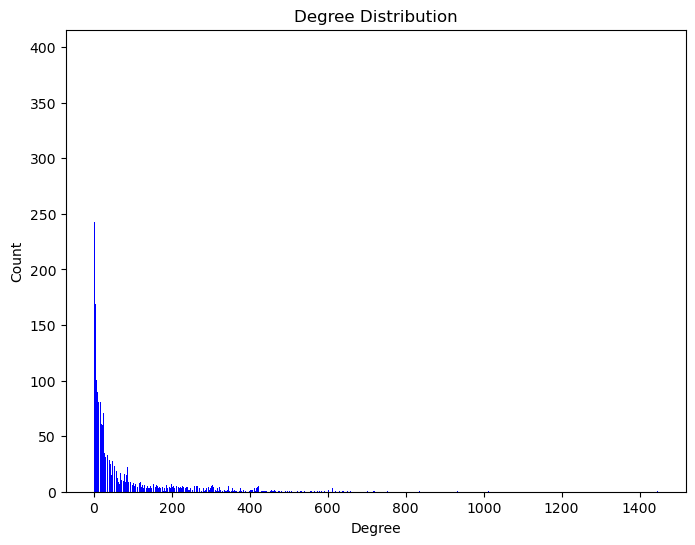

In [39]:
import networkx as nx
import matplotlib.pyplot as plt
from collections import Counter

# Assuming `GG` is your graph (e.g., projected_graph)
# If you don't already have a graph, you can create one like this:
# GG = nx.Graph()
# GG.add_edges_from([(0, 1), (1, 2), (2, 3), (3, 4)])

# Get the degree of each node
degrees = [degree for node, degree in GG.degree()]

# Count the frequency of each degree
degree_count = Counter(degrees)

# Sort the degrees for better visualization
degree, count = zip(*sorted(degree_count.items()))

# Print the degree distribution
print("Degree Distribution (Degree: Count):")
for d, c in zip(degree, count):
    print(f"{d}: {c}")

# Optionally, plot the degree distribution
plt.figure(figsize=(8, 6))
plt.bar(degree, count, width=0.80, color='b')

plt.title("Degree Distribution")
plt.ylabel("Count")
plt.xlabel("Degree")
plt.show()
